In [2]:
import os
import cv2
import numpy as np
import matplotlib.cm as cm
import json
import xmltodict
from scipy.stats import kurtosis, skew, mode
from typing import Tuple
from matplotlib import pyplot as plt
from matplotlib.patches import Polygon
%matplotlib inline

In [3]:
FINAL_DATA = '/Users/ninz/thesis/data/final_data'
ANNOTATIONS = '/Users/ninz/thesis/data/final_data/annotations.xml'
FIGURE_SIZE = 3
test_image = os.path.join(FINAL_DATA, '2_1.JPG')
kurt_list = {'r': [], 'g': [], 'b': [], 'bw': []}
sk_list = {'r': [], 'g': [], 'b': [], 'bw': []}

In [4]:
def convert_xml(file_path: str) -> dict:
    """Convert to dict."""
    with open(file_path) as xml_file:
        data_dict = xmltodict.parse(xml_file.read())

    return json.loads(json.dumps(data_dict))

def convert_from_cvat(xtl: float, ytl: float, xbr: float, ybr: float) -> Tuple[int, int, int, int]:
    """
    Convert format from cvat.

    :param xtl:
    :param ytl:
    :param xbr:
    :param ybr:
    :return:
    """
    x = int(float(xtl))
    y = int(float(ytl))
    w = int(float(xbr)) - x
    h = int(float(ybr)) - y
    return x, y, w, h

def colored_hist(img, ax, label, mask=None, add_to_graph=True):
    color = ('r','g','b')
    for i,col in enumerate(color):
        histr = cv2.calcHist([img], [i], mask, [256], [0,256])
        flat = histr.flatten()
        kurt = kurtosis(flat)
        sk = skew(flat)
        if add_to_graph:
            kurt_list[col].append((round(kurt, 4), label))
            sk_list[col].append((round(sk, 4), label))
        ax.plot(histr,color=col, label=f'ku: {round(kurt, 4)} sk: {round(sk, 4)}')
        ax.set_xlim(0,256)
        ax.legend(loc="upper right")
        
def bw_hist(img, ax, label, mask=None, add_to_graph=True):
    hist_bw = cv2.calcHist([img], [0], None, [256], [0, 256])
    flat = hist_bw.flatten()
    kurt = kurtosis(flat)
    sk = skew(flat)
    if add_to_graph:
        kurt_list['bw'].append((round(kurt, 4), label))
        sk_list['bw'].append((round(sk, 4), label))
    ax.plot(hist_bw, color='k', label=f'ku: {round(kurt, 4)} sk: {round(sk, 4)}')
    ax.set_xlim(0,256)
    ax.legend(loc="upper right")
    
def separate_label(data, label='damage'):
    return [x for x in data if x['@label'] == label]

In [5]:
json_annotations = convert_xml(ANNOTATIONS)
images = {x["@name"]: x for x in json_annotations["annotations"]["image"]}

In [6]:
file_name = '2_3.JPG'
original = os.path.join(FINAL_DATA, file_name)
original = cv2.imread(original)
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
damage_mask = np.zeros(original.shape[:2], np.uint8)
no_damage_mask = np.zeros(original.shape[:2], np.uint8)

meta = images[file_name]
if type(meta["box"]) == dict:
    boxes = [meta["box"]]
else:
    boxes = meta["box"]
    
damage = separate_label(boxes, 'damage')
no_damage = separate_label(boxes, 'no_damage')

In [7]:
def apply_median_filter(image):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image = cv2.medianBlur(image, FIGURE_SIZE)
    return cv2.cvtColor(image, cv2.COLOR_HSV2RGB)


def apply_median_filter_bw(image):
    return cv2.medianBlur(image, FIGURE_SIZE)
                           

def apply_filter(image, filter='median', bw=False):
    if filter == 'median':
        if bw:
            return apply_median_filter_bw(image)
        return apply_median_filter(image)
    return image

def display_compare(images, original, segment, filter=None):
    label = ['damaged', 'no_damage']
    fig, axs = plt.subplots(len(images), 4, figsize=(20, 5))
    fig.suptitle(f'Segment {segment}', fontsize=16)
    fig.tight_layout() 
    for i, box in enumerate(images):
        x, y, w, h = convert_from_cvat(
            box["@xtl"], box["@ytl"],
            box["@xbr"], box["@ybr"]
        )
        if filter is None:
            cropped = original[y:y+h, x:x+w]
        else:
            cropped = apply_filter(original[y:y+h, x:x+w], filter)
            
        axs[i, 0].imshow(cropped)
        axs[i, 0].set_title(f'{box["@label"]}')
        colored_hist(cropped, axs[i, 1], label[i])
        
        if filter is None:
            cropped_bw = cv2.cvtColor(cropped, cv2.COLOR_RGB2GRAY)
        else:
            cropped_bw = cv2.cvtColor(original[y:y+h, x:x+w], cv2.COLOR_RGB2GRAY)
            cropped_bw = apply_filter(cropped_bw, filter, True)
        
        axs[i, 3].imshow(cropped_bw, cmap='gray')
        bw_hist(cropped_bw, axs[i, 2], label[i])
    plt.show()

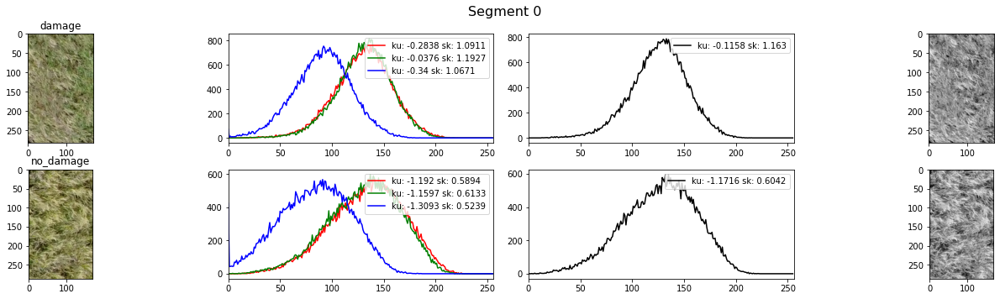

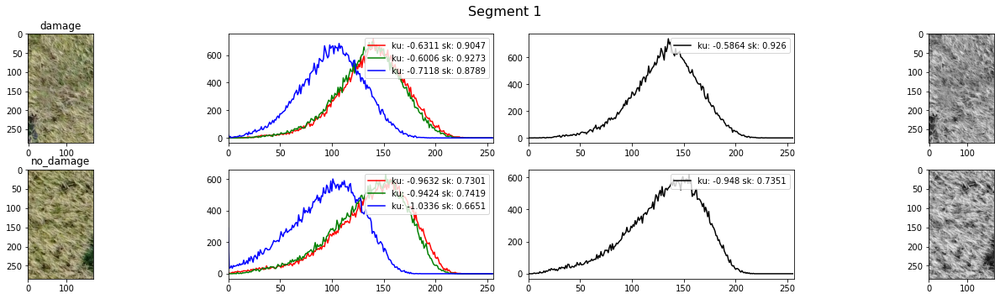

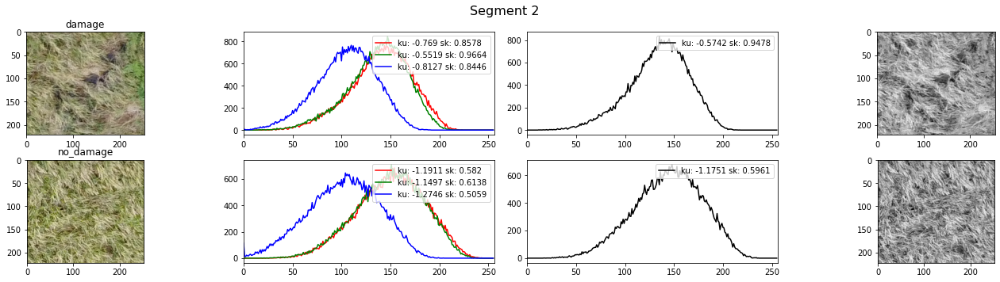

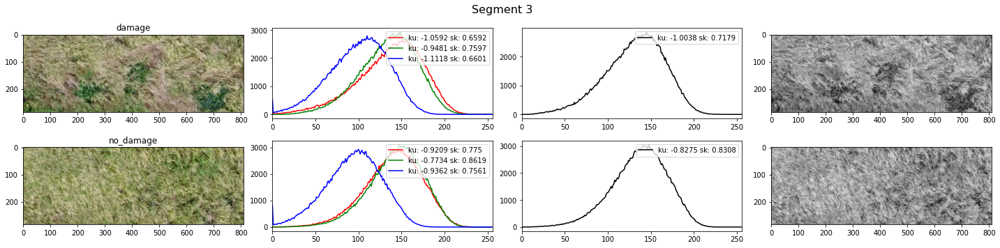

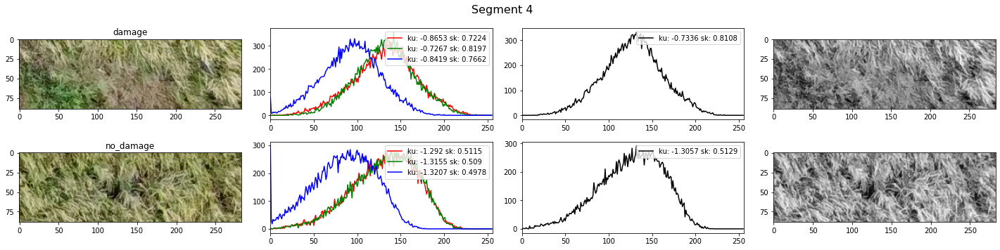

...

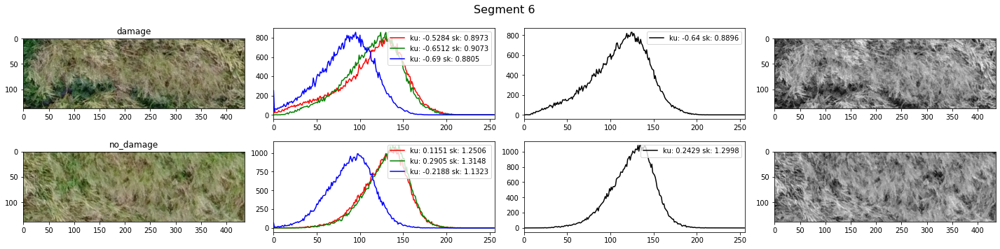

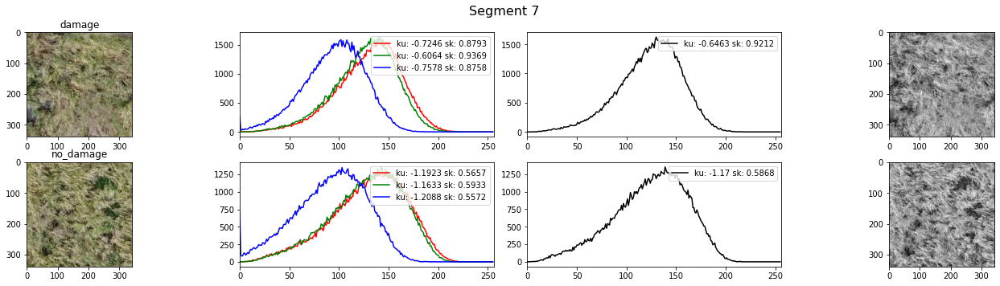

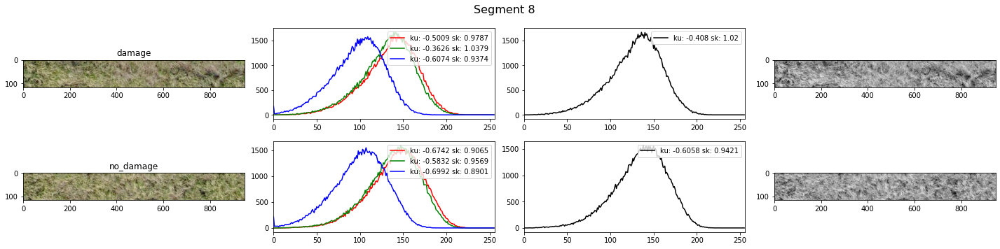

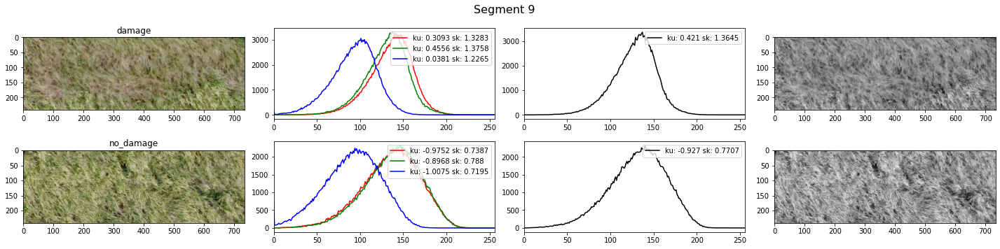

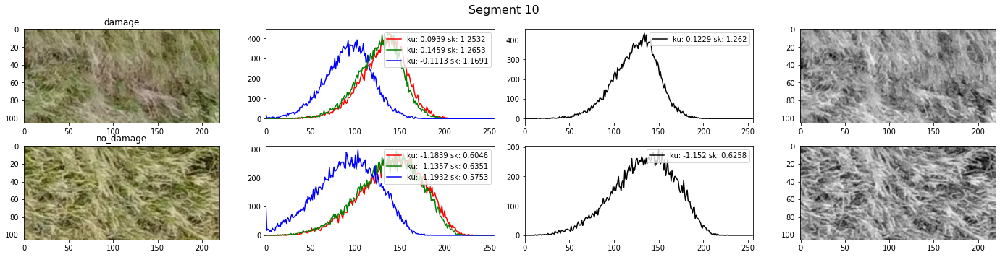

In [8]:
for i in range(len(damage)):
    display_compare([damage[i], no_damage[i]], original, i)
    
    # Compute mask
    # Damage
    x, y, w, h = convert_from_cvat(
        damage[i]["@xtl"], damage[i]["@ytl"],
        damage[i]["@xbr"], damage[i]["@ybr"]
    )
    damage_mask[y:y+h, x:x+w] = 1
    
    # No damage
    x, y, w, h = convert_from_cvat(
        no_damage[i]["@xtl"], no_damage[i]["@ytl"],
        no_damage[i]["@xbr"], no_damage[i]["@ybr"]
    )
    no_damage_mask[y:y+h, x:x+w] = 1

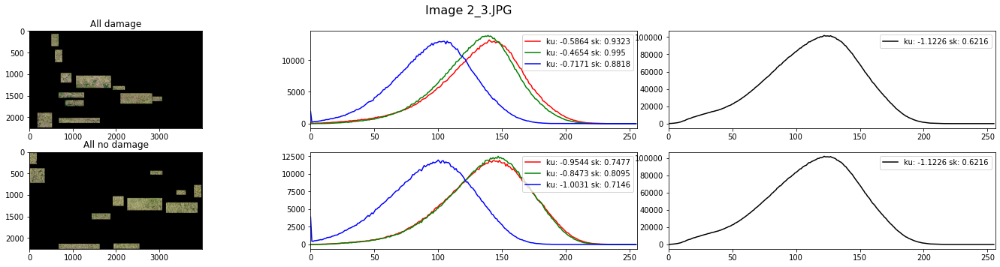

In [22]:
fig, axs = plt.subplots(2, 3, figsize=(20, 5))
fig.suptitle(f'Image {file_name}', fontsize=16)
fig.tight_layout() 
bw_orig = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
damage_masked_img = cv2.bitwise_and(original, original, mask=damage_mask)
no_damage_masked_img = cv2.bitwise_and(original, original, mask=no_damage_mask)
axs[0, 0].imshow(damage_masked_img)
axs[1, 0].imshow(no_damage_masked_img)
axs[0, 0].set_title('All damage')
axs[1, 0].set_title('All no damage')
colored_hist(original, axs[0, 1], 'damaged', mask=damage_mask, add_to_graph=False)
colored_hist(original, axs[1, 1], 'no_damage', mask=no_damage_mask, add_to_graph=False)
bw_hist(bw_orig, axs[0, 2], 'no_damage', mask=damage_mask, add_to_graph=False)
bw_hist(bw_orig, axs[1, 2], 'damaged', mask=no_damage_mask, add_to_graph=False)
plt.show()

In [10]:
def graph_comparison(data, title, measure='skewness'):
    damaged = []
    no_damage = []
    fig, ax = plt.subplots()
    for item in data:
        num_data = item[0]
        if measure == 'kurtosis':
            num_data = abs(item[0])
        if item[1] == 'damaged':
            damaged.append(num_data)
        else:
            no_damage.append(num_data)

    ax.scatter(x=range(len(damaged)), y=damaged, marker='^', label='damaged', alpha=0.8, edgecolors='none')
    ax.scatter(x=range(len(no_damage)), y=no_damage, marker='o', label='no_damage', alpha=0.8, edgecolors='none')
    ax.legend()
    ax.grid(True)
    ax.set_xlabel('Segment #')
    ax.set_ylabel('Skewness Value')
    ax.set_title(title)
    plt.show()

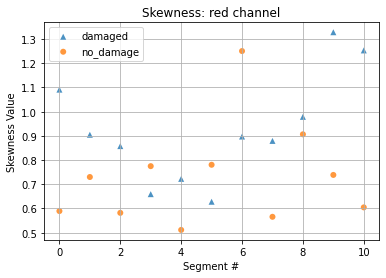

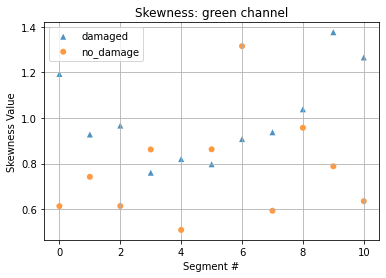

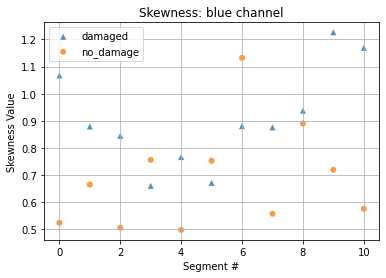

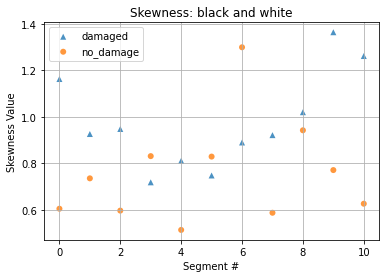

In [11]:
graph_comparison(sk_list['r'], 'Skewness: red channel')
graph_comparison(sk_list['g'], 'Skewness: green channel')
graph_comparison(sk_list['b'], 'Skewness: blue channel')
graph_comparison(sk_list['bw'], 'Skewness: black and white')

### Skewness graph observation

- There seems to be no distinct threshold that can separate the damage vs the not damaged based on skewness.
- In most cases, damaged area has a high skewness value in both RGB and BW colorspace
- Damaged data is somewhat moderately skewed to the right


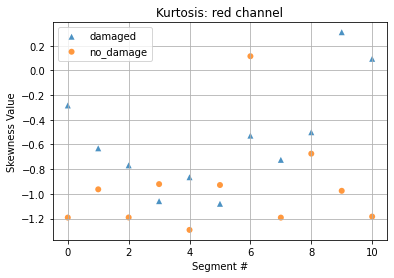

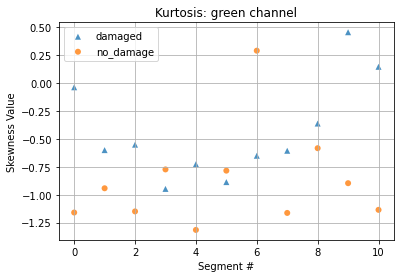

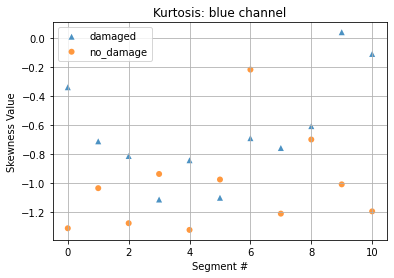

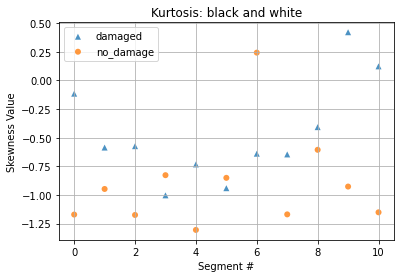

In [12]:
graph_comparison(kurt_list['r'], 'Kurtosis: red channel')
graph_comparison(kurt_list['g'], 'Kurtosis: green channel')
graph_comparison(kurt_list['b'], 'Kurtosis: blue channel')
graph_comparison(kurt_list['bw'], 'Kurtosis: black and white')

### Kurtosis

- Damaged segments seem to have higher kurtosis value, meaning its closer to a normal distribution.
- There also seems to be no significant distinction that can be drawn between damage and no damage segments.

Maybe there is a need to increase sample size? Will including other images help to get a bigger picture?

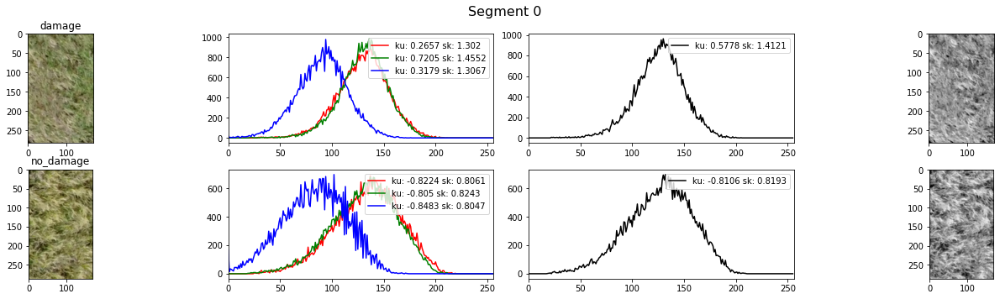

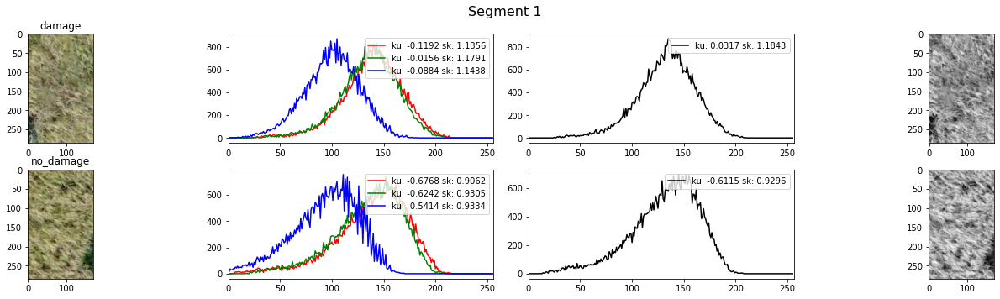

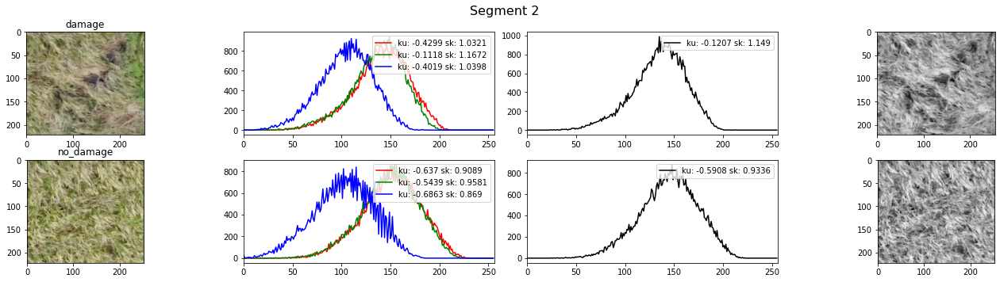

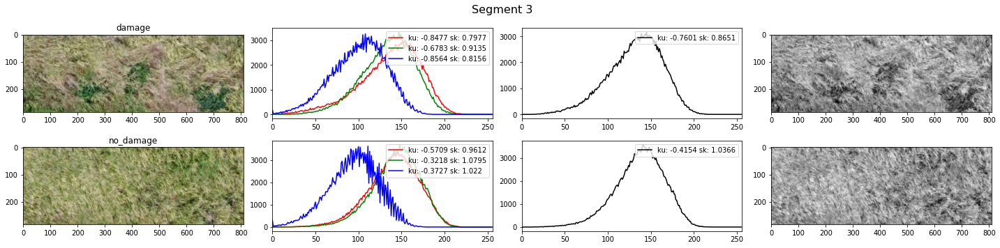

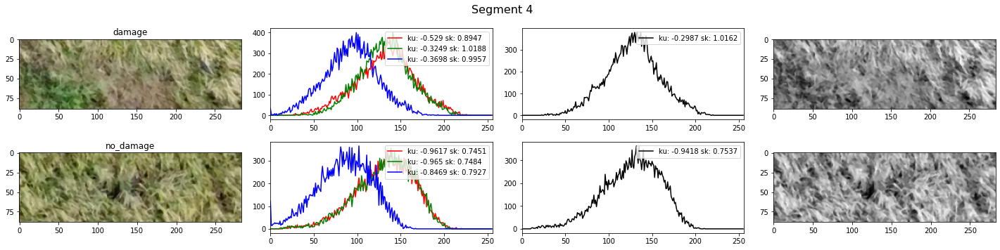

...

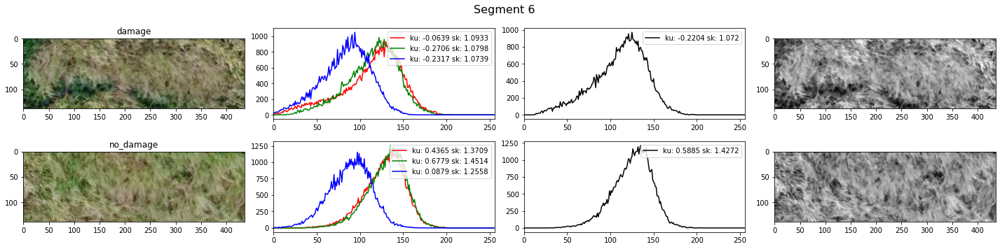

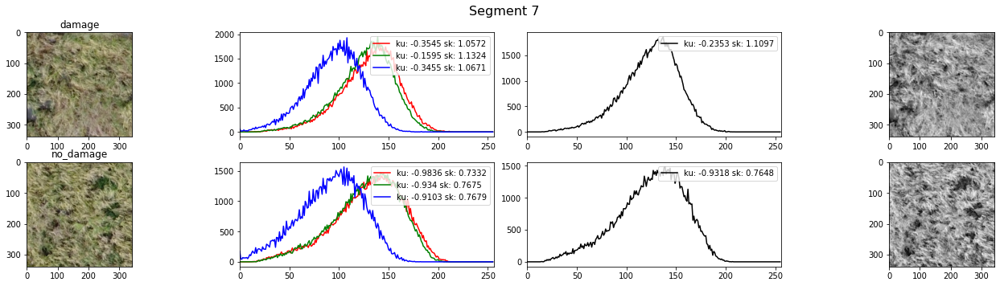

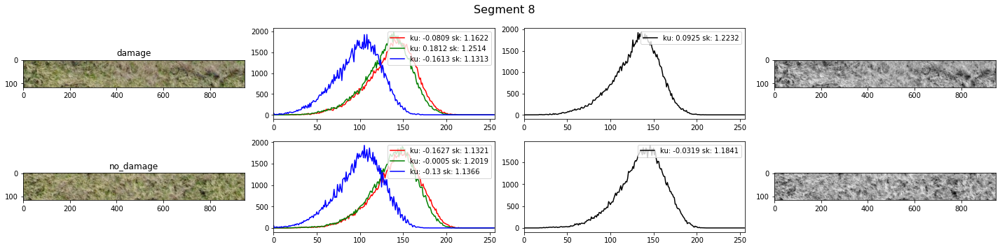

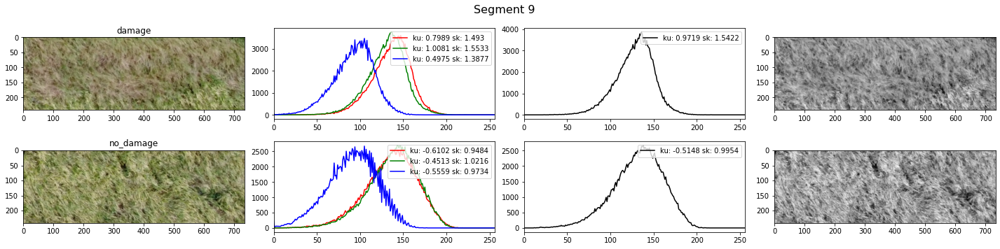

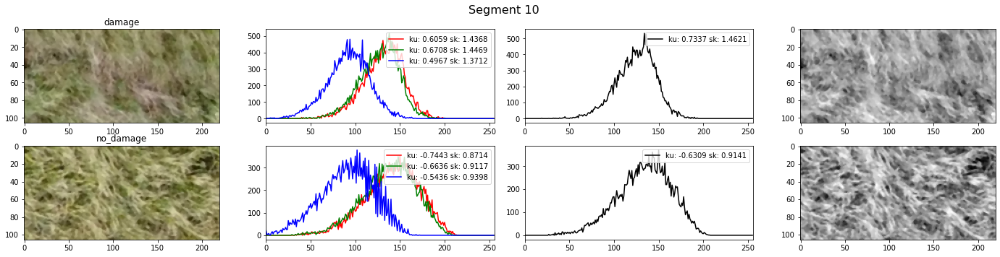

In [13]:
kurt_list = {'r': [], 'g': [], 'b': [], 'bw': []}
sk_list = {'r': [], 'g': [], 'b': [], 'bw': []}

for i in range(len(damage)):
    display_compare([damage[i], no_damage[i]], original, i, 'median')
    
#     # Compute mask
#     # Damage
#     x, y, w, h = convert_from_cvat(
#         damage[i]["@xtl"], damage[i]["@ytl"],
#         damage[i]["@xbr"], damage[i]["@ybr"]
#     )
#     damage_mask[y:y+h, x:x+w] = 1
    
#     # No damage
#     x, y, w, h = convert_from_cvat(
#         no_damage[i]["@xtl"], no_damage[i]["@ytl"],
#         no_damage[i]["@xbr"], no_damage[i]["@ybr"]
#     )
#     no_damage_mask[y:y+h, x:x+w] = 1

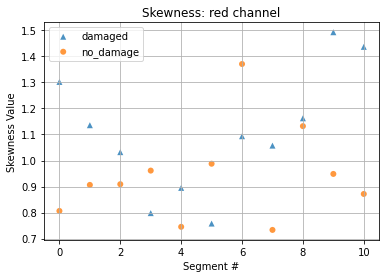

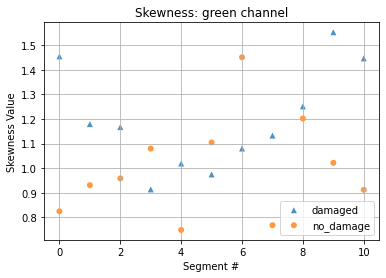

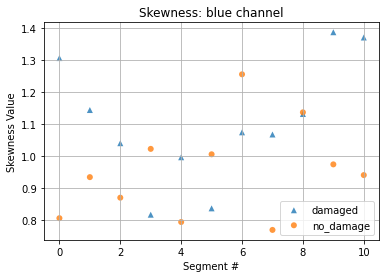

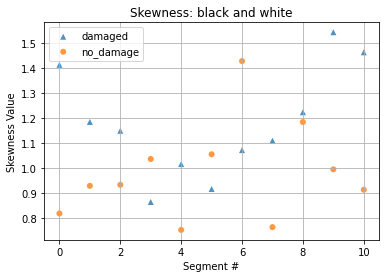

In [14]:
graph_comparison(sk_list['r'], 'Skewness: red channel')
graph_comparison(sk_list['g'], 'Skewness: green channel')
graph_comparison(sk_list['b'], 'Skewness: blue channel')
graph_comparison(sk_list['bw'], 'Skewness: black and white')

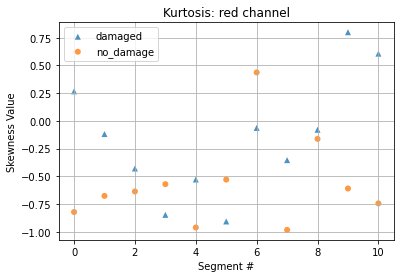

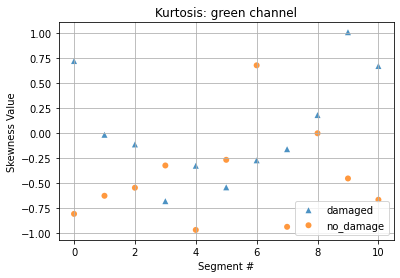

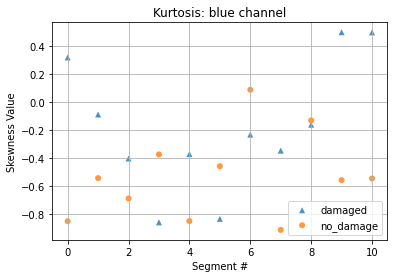

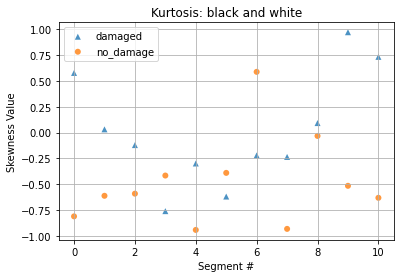

In [15]:
graph_comparison(kurt_list['r'], 'Kurtosis: red channel')
graph_comparison(kurt_list['g'], 'Kurtosis: green channel')
graph_comparison(kurt_list['b'], 'Kurtosis: blue channel')
graph_comparison(kurt_list['bw'], 'Kurtosis: black and white')

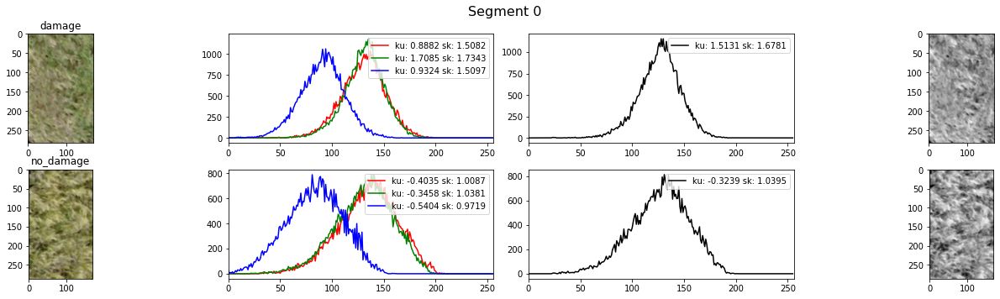

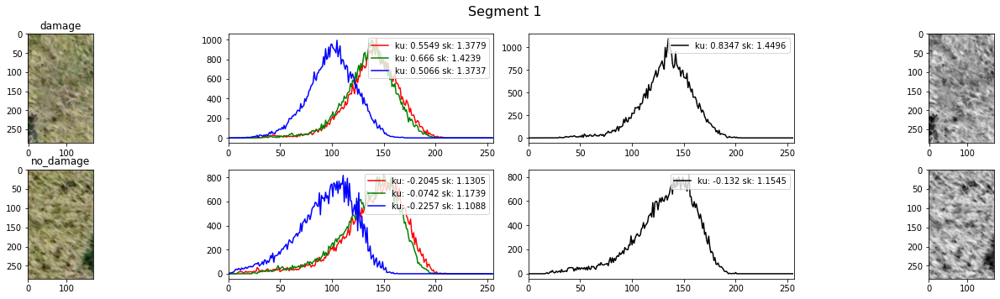

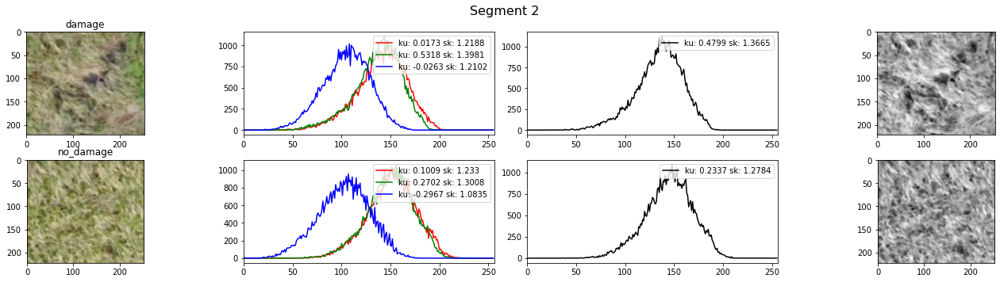

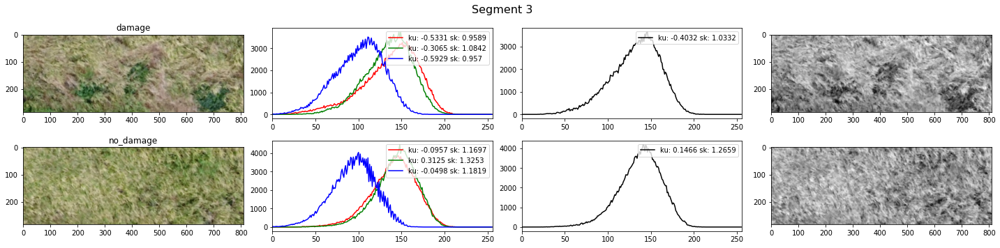

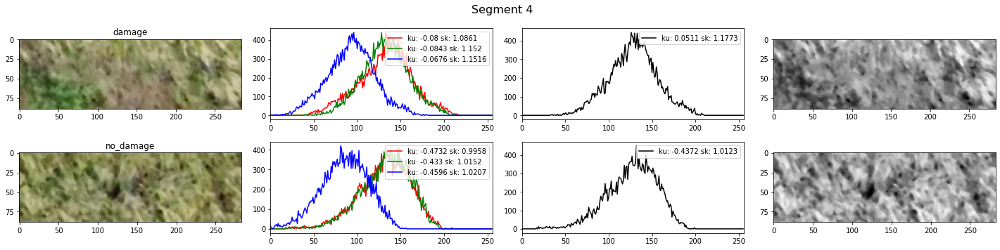

...

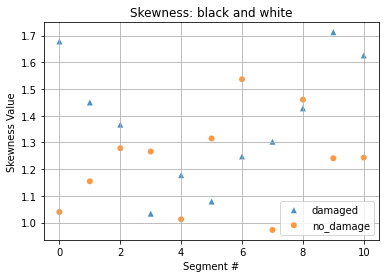

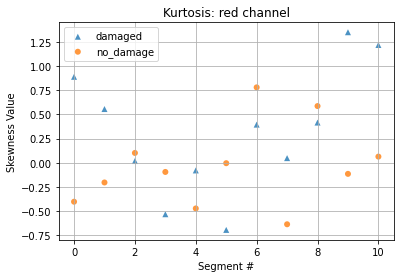

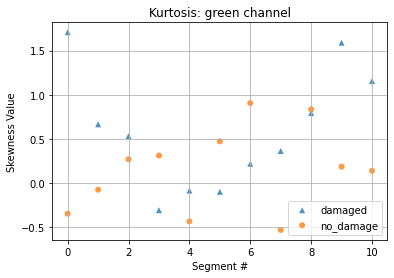

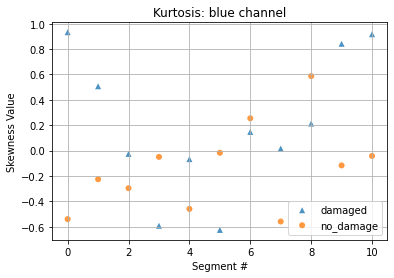

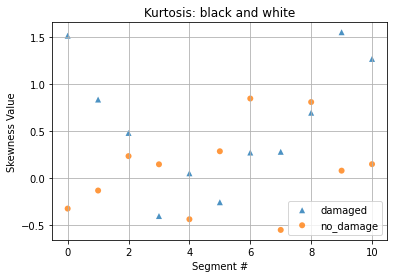

In [16]:
FIGURE_SIZE = 5
kurt_list = {'r': [], 'g': [], 'b': [], 'bw': []}
sk_list = {'r': [], 'g': [], 'b': [], 'bw': []}

for i in range(len(damage)):
    display_compare([damage[i], no_damage[i]], original, i, 'median')
    
graph_comparison(sk_list['r'], 'Skewness: red channel')
graph_comparison(sk_list['g'], 'Skewness: green channel')
graph_comparison(sk_list['b'], 'Skewness: blue channel')
graph_comparison(sk_list['bw'], 'Skewness: black and white')
graph_comparison(kurt_list['r'], 'Kurtosis: red channel')
graph_comparison(kurt_list['g'], 'Kurtosis: green channel')
graph_comparison(kurt_list['b'], 'Kurtosis: blue channel')
graph_comparison(kurt_list['bw'], 'Kurtosis: black and white')

In [31]:
file_name = '2_3.JPG'
original2 = os.path.join(FINAL_DATA, file_name)
original2 = cv2.imread(original2)
original2 = cv2.cvtColor(original2, cv2.COLOR_BGR2RGB)

meta = images[file_name]
if type(meta["box"]) == dict:
    boxes = [meta["box"]]
else:
    boxes = meta["box"]
    
damage = separate_label(boxes, 'damage')
no_damage = separate_label(boxes, 'no_damage')

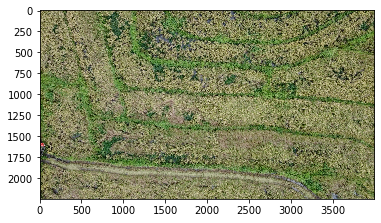

In [32]:
# plt.figure(figsize = (300,100))
plt.imshow(original2, interpolation='nearest')

(511, 72) (681, 355)
(592, 439) (762, 725)
(725, 973) (979, 1195)
(1082, 1034) (1891, 1318)
(1930, 1276) (2214, 1365)
(675, 1423) (1273, 1546)
(826, 1599) (1262, 1738)
(186, 1891) (528, 2230)
(684, 2010) (1632, 2127)
(2111, 1440) (2845, 1682)
(2853, 1518) (3073, 1624)


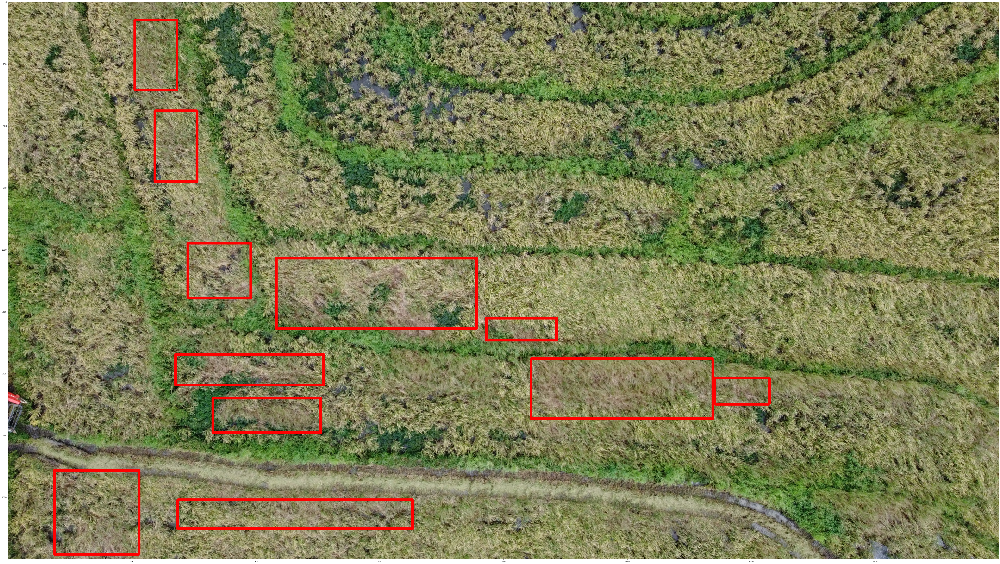

In [33]:
for box in damage:
    start = (int(float(box["@xtl"])), int(float(box["@ytl"])))
    end = (int(float(box["@xbr"])), int(float(box["@ybr"])))
    print(start, end)
    original2 = cv2.rectangle(original2, start, end, (255,0,0), 10)

plt.figure(figsize = (100,50))
plt.imshow(original2, interpolation='nearest')

In [64]:
def get_cropped(box, img):
    xtl = int(float(box["@xtl"]))
    ytl = int(float(box["@ytl"]))
    xbr = int(float(box["@xbr"]))
    ybr = int(float(box["@ybr"]))
    return img[ytl:ybr, xtl:xbr]


def colored_hist2(img, ax, label):
    color = ('r','g','b')
    for i,col in enumerate(color):
        histr = cv2.calcHist([img], [i], None, [256], [0,256])
        flat = histr.flatten()
        kurt = kurtosis(flat)
        sk = skew(flat)
        ax.plot(histr,color=col, label=f'ku: {round(kurt, 4)} sk: {round(sk, 4)}')
        ax.set_xlim(0,256)
        ax.legend(loc="upper right")
        
def bw_hist2(img, ax, label):
    hist_bw = cv2.calcHist([img], [0], None, [256], [0, 256])
    flat = hist_bw.flatten()
    kurt = kurtosis(flat)
    sk = skew(flat)
    ax.plot(hist_bw, color='k', label=f'ku: {round(kurt, 4)} sk: {round(sk, 4)}')
    ax.set_xlim(0,256)
    ax.legend(loc="upper right")



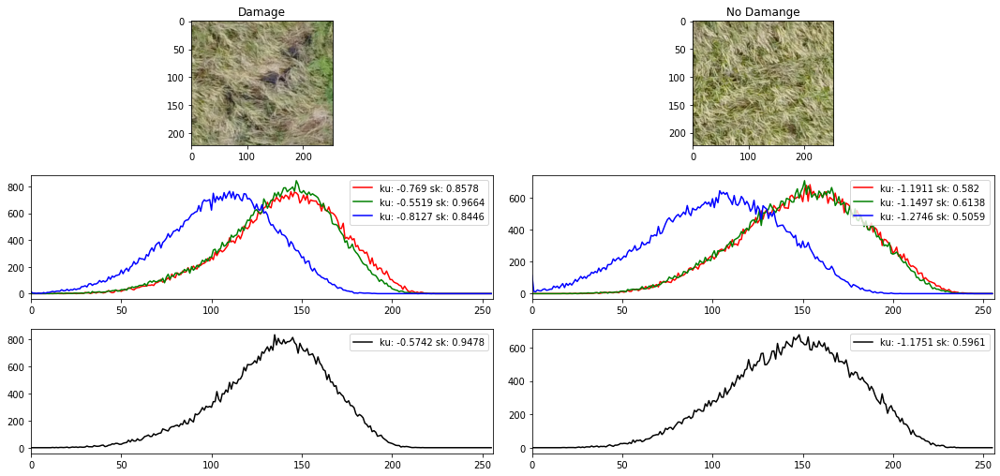

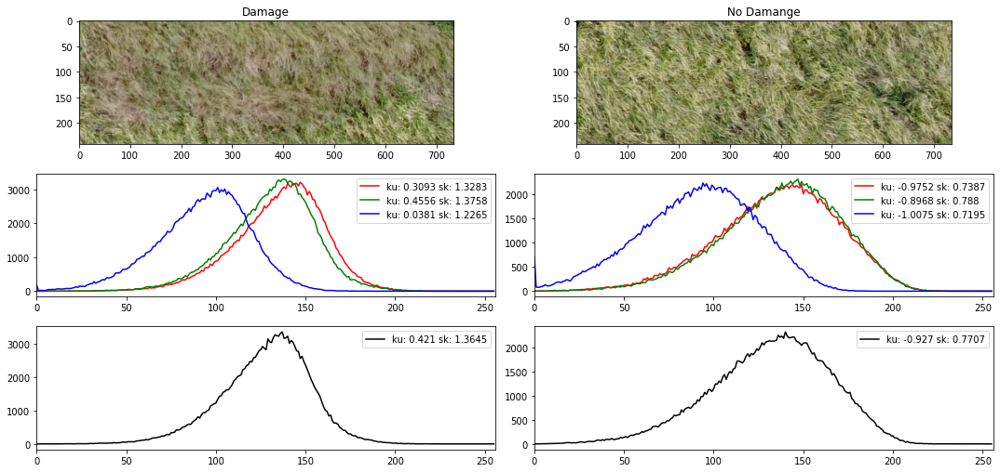

In [66]:
target = [2, 9]

for i in range(len(damage)):
    
    if i not in target:
        continue
    
    fig, axs = plt.subplots(3, 2, figsize=(15, 7))
    # fig.suptitle(f'Segment {segment}', fontsize=16)
    fig.tight_layout() 
    
    damage_img = get_cropped(damage[i], original)
    no_damage_img = get_cropped(no_damage[i], original)
    
    axs[0, 0].imshow(damage_img)
    axs[0, 0].set_title('Damage')
    colored_hist2(damage_img, axs[1, 0], '')
    cropped_bw = cv2.cvtColor(damage_img, cv2.COLOR_RGB2GRAY)
    bw_hist2(cropped_bw, axs[2, 0], '')
    
    axs[0, 1].imshow(no_damage_img)
    axs[0, 1].set_title('No Damange')
    colored_hist2(no_damage_img, axs[1, 1], '')
    cropped_bw = cv2.cvtColor(no_damage_img, cv2.COLOR_RGB2GRAY)
    bw_hist2(cropped_bw, axs[2, 1], '')
    
    plt.show()